In [1]:
import os
import xml.etree.ElementTree as ET
from PIL import Image
import glob

# Directories
images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'
output_images_dir = '/kaggle/working/new_cropped_dataset/images'
output_labels_path = '/kaggle/working/new_cropped_dataset/labels.txt'

# Create output directory
os.makedirs(output_images_dir, exist_ok=True)

# Load all annotation files
xml_files = glob.glob(os.path.join(annotations_dir, '*.xml'))

# Counter for unique cropped filenames
crop_counter = 0

# Open the labels file to write labels
with open(output_labels_path, 'w') as label_file:
    for xml_file in xml_files:
        tree = ET.parse(xml_file)
        root = tree.getroot()

        # Get image filename from XML
        filename = root.find('filename').text
        image_path = os.path.join(images_dir, filename)

        if not os.path.exists(image_path):
            continue

        # Load image
        image = Image.open(image_path)
        width, height = image.size
        image_area = width * height

        for obj in root.findall('object'):
            label = obj.find('name').text
            bndbox = obj.find('bndbox')

            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)

            # Compute bounding box area
            box_width = xmax - xmin
            box_height = ymax - ymin
            box_area = box_width * box_height

            # Skip small bounding boxes
            if box_area < 0.01 * image_area:
                continue

            # Add 15% margin
            margin_x = int(box_width * 0.15)
            margin_y = int(box_height * 0.15)

            # Apply margin and clamp to image bounds
            xmin_crop = max(0, xmin - margin_x)
            ymin_crop = max(0, ymin - margin_y)
            xmax_crop = min(width, xmax + margin_x)
            ymax_crop = min(height, ymax + margin_y)

            # Crop and save image
            cropped_img = image.crop((xmin_crop, ymin_crop, xmax_crop, ymax_crop))
            cropped_filename = f"crop_{crop_counter:05d}.jpg"
            cropped_img.save(os.path.join(output_images_dir, cropped_filename))

            # Save label
            label_file.write(f"{cropped_filename}\t{label}\n")
            crop_counter += 1

print(f"Total cropped images saved: {crop_counter}")

Total cropped images saved: 22404


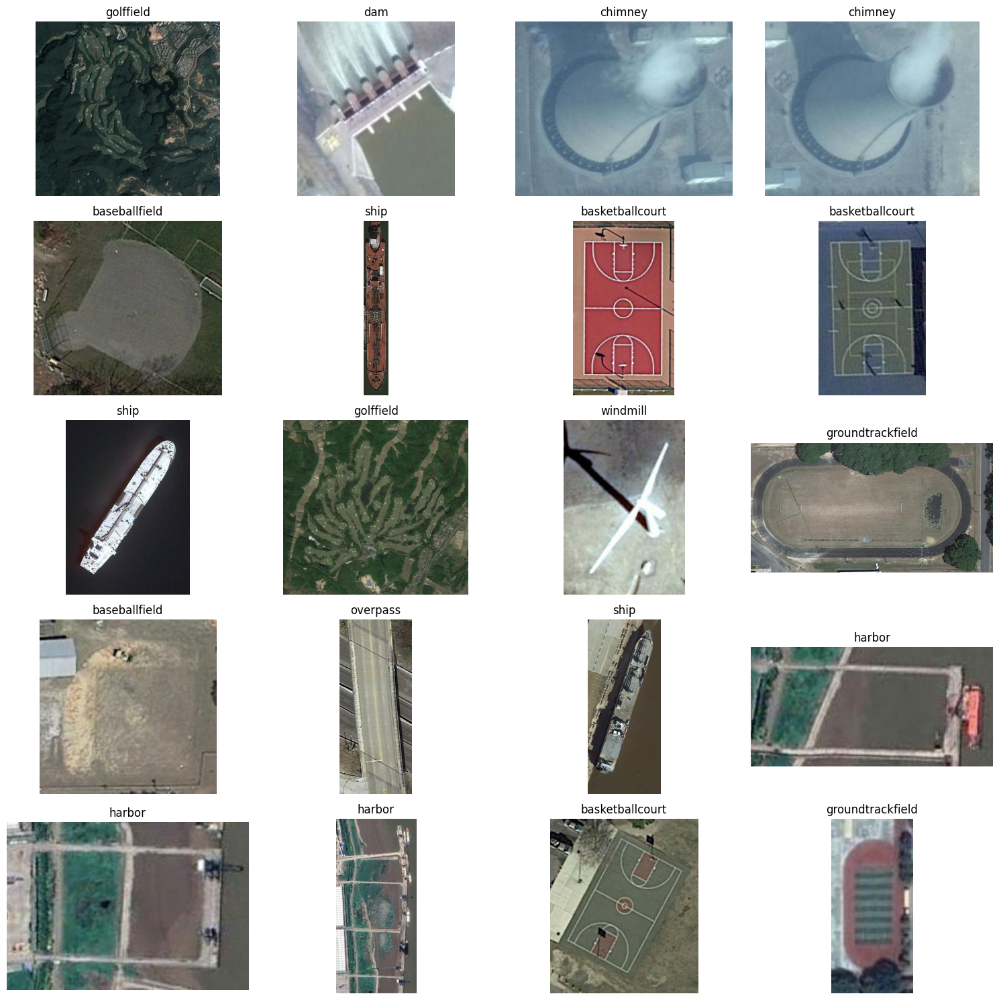

In [2]:
import matplotlib.pyplot as plt
from PIL import Image

# Load labels from file
with open(output_labels_path, 'r') as f:
    lines = f.readlines()

# Pick 20 samples
sample_lines = lines[:20]

# Set up the plot
plt.figure(figsize=(15, 15))
for i, line in enumerate(sample_lines):
    filename, label = line.strip().split('\t')
    img_path = os.path.join(output_images_dir, filename)
    
    img = Image.open(img_path)

    plt.subplot(5, 4, i + 1)
    plt.imshow(img)
    plt.title(label)
    plt.axis('off')

plt.tight_layout()
plt.show()


In [3]:
from collections import Counter

# Read labels
with open(output_labels_path, 'r') as f:
    lines = f.readlines()

# Extract labels
labels = [line.strip().split('\t')[1] for line in lines]

# Count occurrences of each label
label_counts = Counter(labels)
total = sum(label_counts.values())

# Calculate percentages
label_percentages = {label: (count / total) * 100 for label, count in label_counts.items()}

# Display
print("Class Distribution (%):")
for label, percentage in sorted(label_percentages.items(), key=lambda x: x[1], reverse=True):
    print(f"{label}: {percentage:.2f}%")

Class Distribution (%):
baseballfield: 14.16%
airplane: 6.37%
overpass: 6.29%
groundtrackfield: 6.20%
Expressway-Service-area: 5.79%
airport: 5.48%
ship: 5.37%
tenniscourt: 5.21%
chimney: 5.13%
bridge: 4.98%
basketballcourt: 4.95%
golffield: 4.51%
storagetank: 4.29%
stadium: 4.24%
dam: 4.02%
trainstation: 3.91%
windmill: 3.47%
Expressway-toll-station: 2.68%
harbor: 1.90%
vehicle: 1.04%


In [4]:
from collections import Counter

# Read labels
with open(output_labels_path, 'r') as f:
    lines = f.readlines()

# Extract labels
labels = [line.strip().split('\t')[1] for line in lines]

# Count occurrences of each label
label_counts = Counter(labels)

# Display
print("Number of Images per Class:")
for label, count in sorted(label_counts.items(), key=lambda x: x[1], reverse=True):
    print(f"{label}: {count}")

Number of Images per Class:
baseballfield: 3173
airplane: 1427
overpass: 1410
groundtrackfield: 1390
Expressway-Service-area: 1297
airport: 1228
ship: 1202
tenniscourt: 1168
chimney: 1150
bridge: 1116
basketballcourt: 1109
golffield: 1010
storagetank: 961
stadium: 951
dam: 900
trainstation: 877
windmill: 777
Expressway-toll-station: 601
harbor: 425
vehicle: 232


In [5]:
import shutil

shutil.make_archive('/kaggle/working/new_cropped_dataset', 'zip', '/kaggle/working/new_cropped_dataset')


'/kaggle/working/new_cropped_dataset.zip'

In [6]:
import os
import xml.etree.ElementTree as ET
import glob
import numpy as np

# Directories
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'

# Load all annotation files
xml_files = glob.glob(os.path.join(annotations_dir, '*.xml'))

bbox_percentages = []

for xml_file in xml_files:
    tree = ET.parse(xml_file)
    root = tree.getroot()

    # Get image filename from XML
    filename = root.find('filename').text
    image_path = os.path.join('/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages', filename)

    if not os.path.exists(image_path):
        continue

    # Load image size
    from PIL import Image
    image = Image.open(image_path)
    width, height = image.size
    image_area = width * height

    for obj in root.findall('object'):
        bndbox = obj.find('bndbox')

        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)

        bbox_area = (xmax - xmin) * (ymax - ymin)
        bbox_percentage = (bbox_area / image_area) * 100

        bbox_percentages.append(bbox_percentage)

# Convert to numpy array for easy calculation
bbox_percentages = np.array(bbox_percentages)

# Calculate statistics

total_boxes = len(bbox_percentages)
less_than_1 = np.sum(bbox_percentages < 1) / total_boxes * 100
less_than_5 = np.sum(bbox_percentages < 5) / total_boxes * 100

less_than_10 = np.sum(bbox_percentages < 10) / total_boxes * 100
less_than_15 = np.sum(bbox_percentages < 15) / total_boxes * 100
less_than_20 = np.sum(bbox_percentages < 20) / total_boxes * 100

print(f"Total bounding boxes: {total_boxes}")
print(f"Bounding boxes <1% of image area: {less_than_1:.2f}%")
print(f"Bounding boxes <5% of image area: {less_than_5:.2f}%")
print(f"Bounding boxes <10% of image area: {less_than_10:.2f}%")
print(f"Bounding boxes <15% of image area: {less_than_15:.2f}%")
print(f"Bounding boxes <20% of image area: {less_than_20:.2f}%")

Total bounding boxes: 38320
Bounding boxes <1% of image area: 41.53%
Bounding boxes <5% of image area: 66.87%
Bounding boxes <10% of image area: 79.30%
Bounding boxes <15% of image area: 85.02%
Bounding boxes <20% of image area: 88.70%


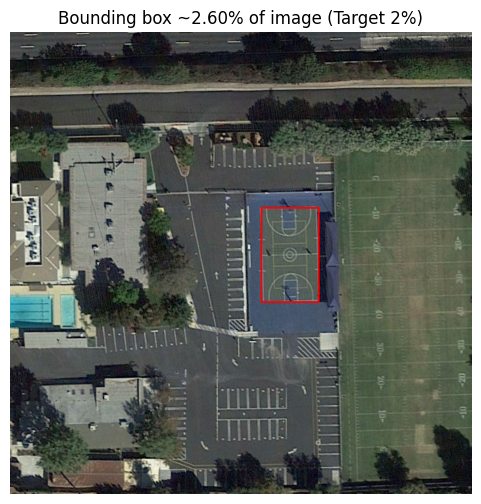

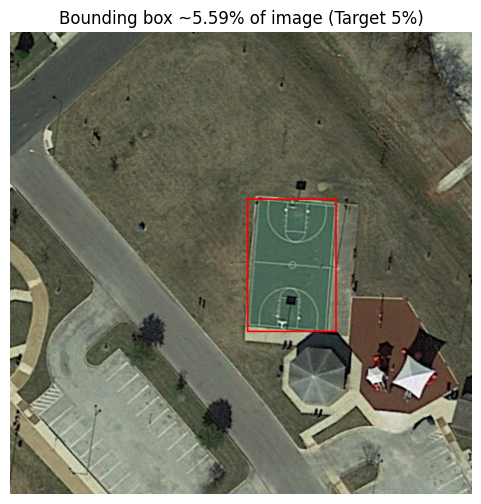

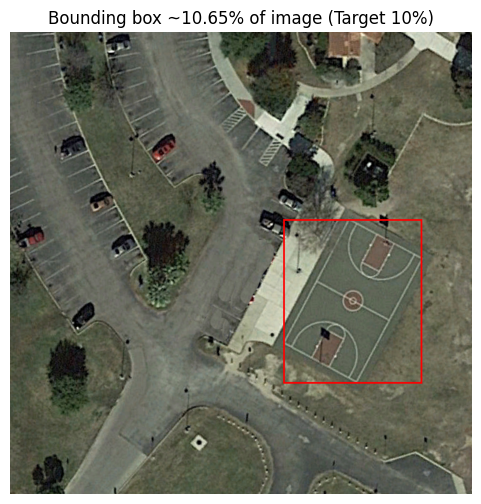

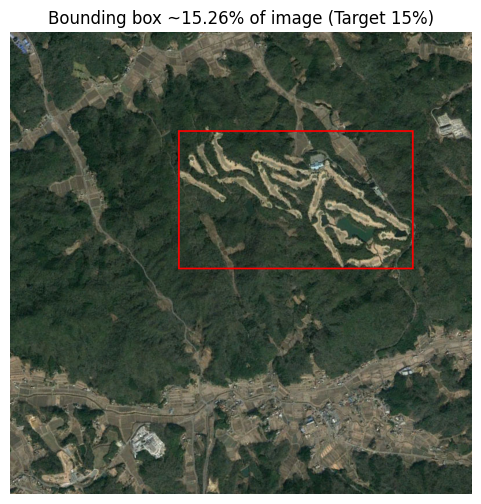

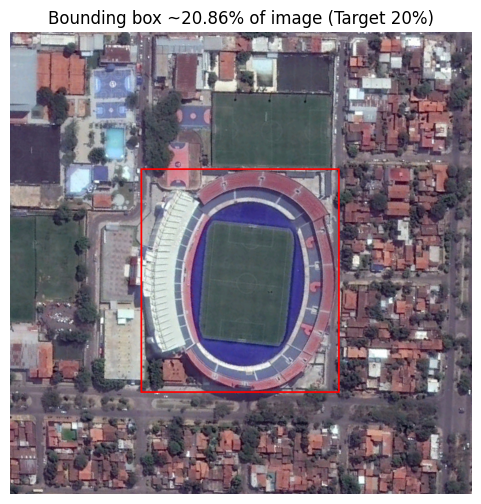

In [12]:
import os
import xml.etree.ElementTree as ET
import glob
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt

# Directories
images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'

# Load all annotation files
xml_files = glob.glob(os.path.join(annotations_dir, '*.xml'))

targets = [2, 5, 10, 15, 20]  # % targets
found_examples = {t: None for t in targets}  # to store one example per target

for xml_file in xml_files:
    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    image_path = os.path.join(images_dir, filename)

    if not os.path.exists(image_path):
        continue

    image = Image.open(image_path)
    width, height = image.size
    image_area = width * height

    for obj in root.findall('object'):
        bndbox = obj.find('bndbox')

        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)

        bbox_area = (xmax - xmin) * (ymax - ymin)
        bbox_percentage = (bbox_area / image_area) * 100

        # Check if we are close to any target percentage (allow small margin like ±1%)
        for target in targets:
            if (found_examples[target] is None) and (abs(bbox_percentage - target) <= 1):
                found_examples[target] = (image_path, (xmin, ymin, xmax, ymax), bbox_percentage)
        
    # Stop early if all examples found
    if all(found_examples.values()):
        break

# Now visualize the examples
for target, info in found_examples.items():
    if info:
        image_path, bbox, percentage = info
        image = Image.open(image_path).convert("RGB")
        draw = ImageDraw.Draw(image)
        draw.rectangle(bbox, outline="red", width=3)

        plt.figure(figsize=(6, 6))
        plt.imshow(image)
        plt.title(f'Bounding box ~{percentage:.2f}% of image (Target {target}%)')
        plt.axis('off')
        plt.show()
    else:
        print(f"No example found for target {target}%.")

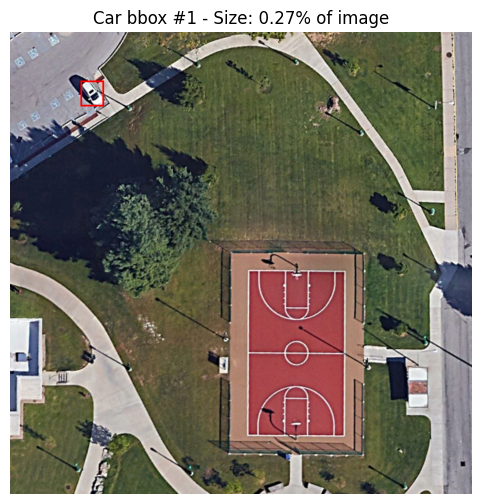

Car bbox #1: 0.27% of image


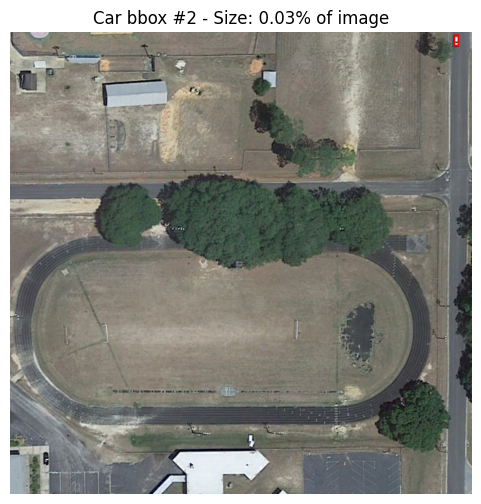

Car bbox #2: 0.03% of image


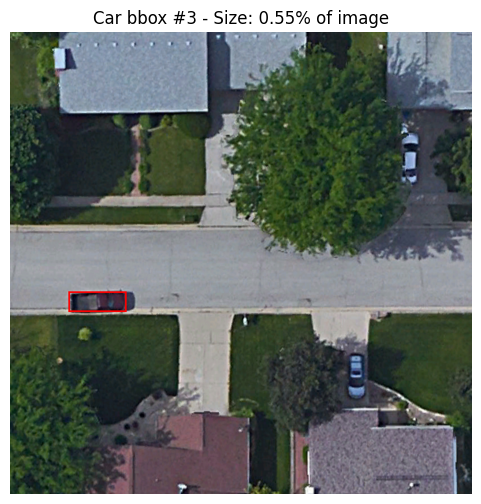

Car bbox #3: 0.55% of image


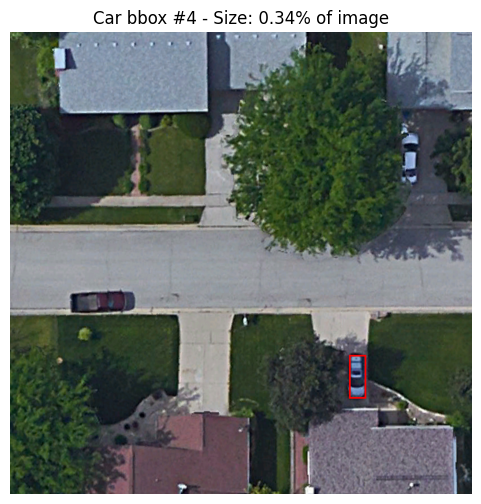

Car bbox #4: 0.34% of image


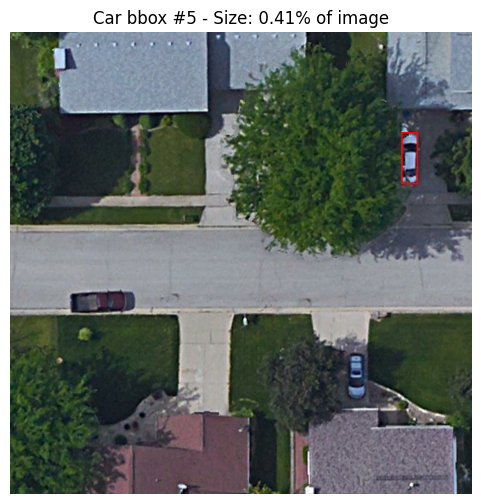

Car bbox #5: 0.41% of image


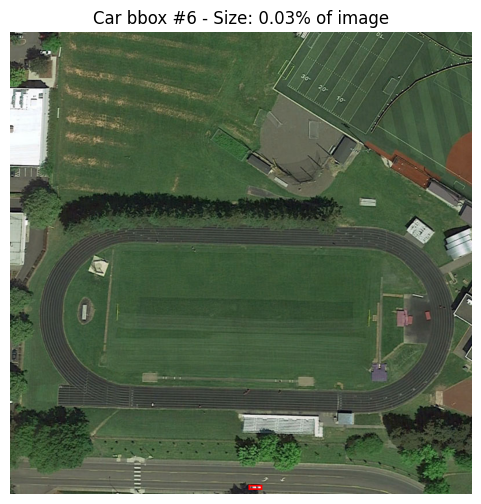

Car bbox #6: 0.03% of image


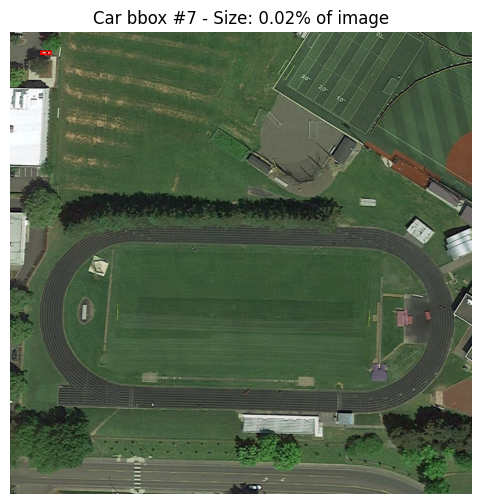

Car bbox #7: 0.02% of image


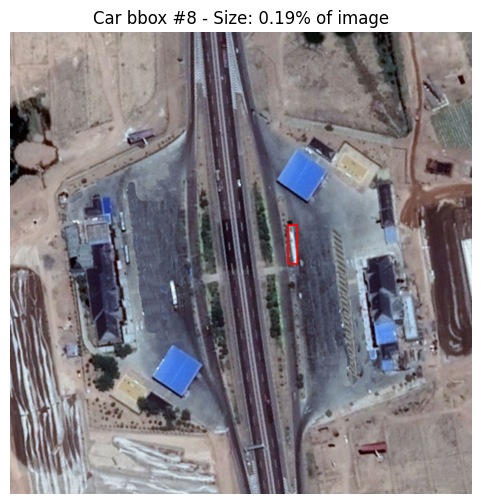

Car bbox #8: 0.19% of image


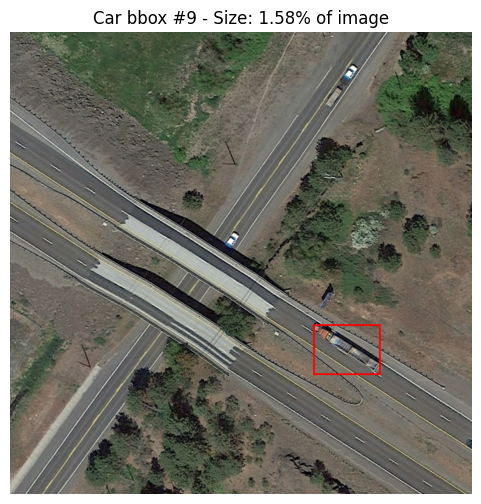

Car bbox #9: 1.58% of image


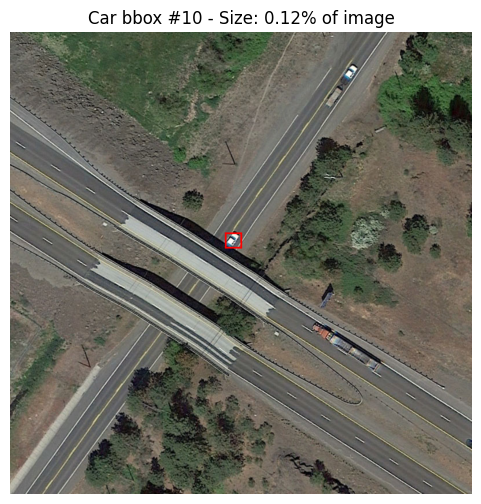

Car bbox #10: 0.12% of image


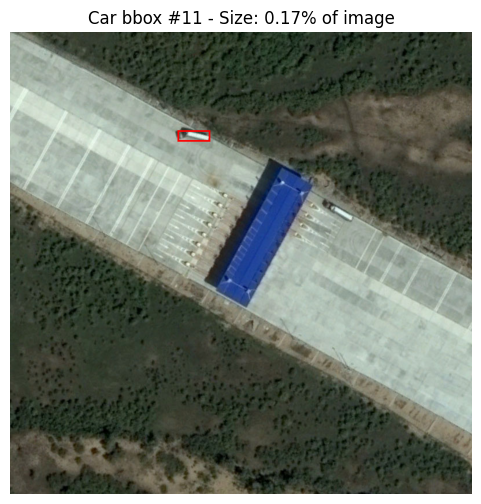

Car bbox #11: 0.17% of image


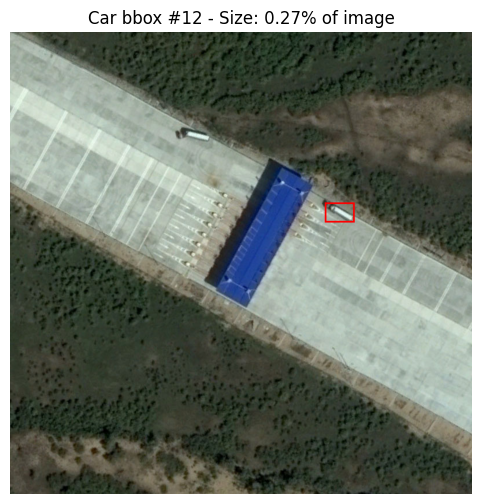

Car bbox #12: 0.27% of image


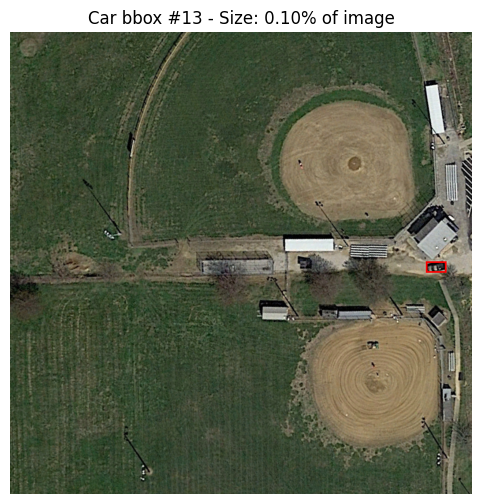

Car bbox #13: 0.10% of image


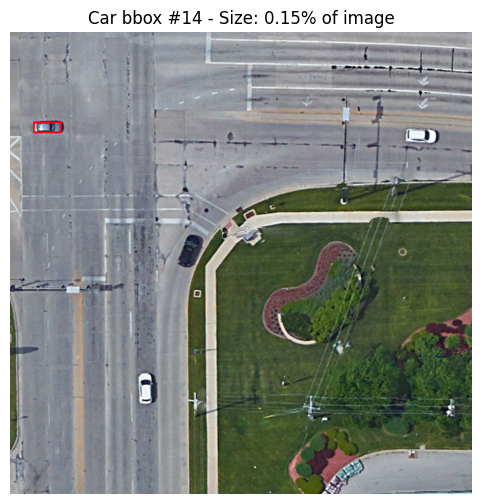

Car bbox #14: 0.15% of image


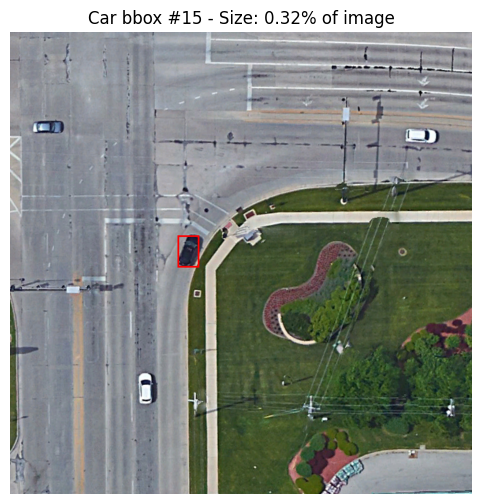

Car bbox #15: 0.32% of image


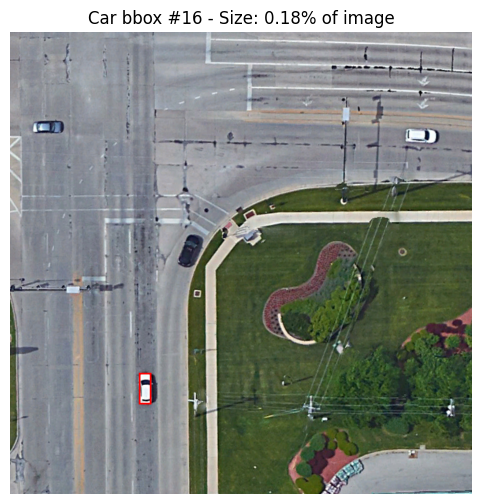

Car bbox #16: 0.18% of image


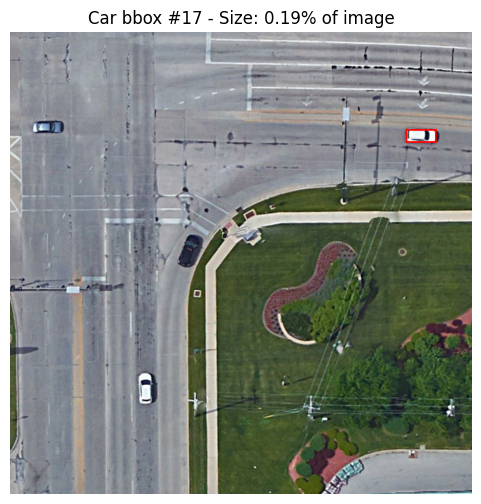

Car bbox #17: 0.19% of image


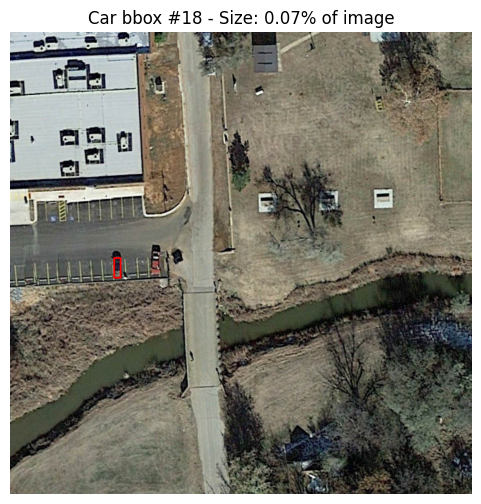

Car bbox #18: 0.07% of image


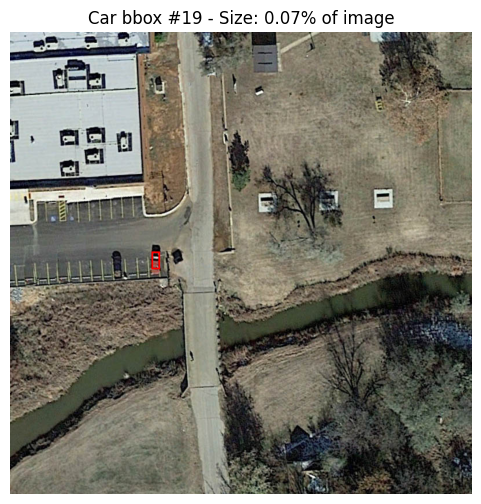

Car bbox #19: 0.07% of image


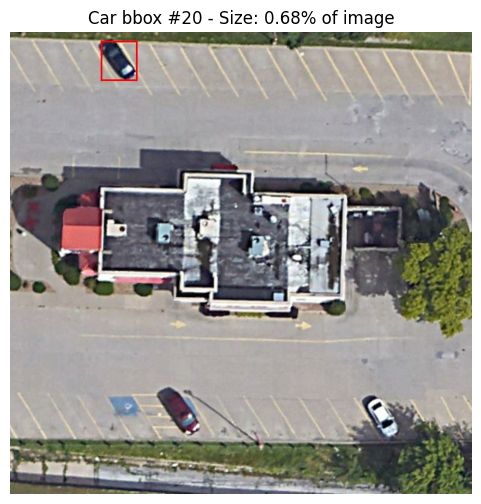

Car bbox #20: 0.68% of image


In [15]:
import os
import xml.etree.ElementTree as ET
import glob
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# Directories
images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'

# Load all annotation files
xml_files = glob.glob(os.path.join(annotations_dir, '*.xml'))

car_examples = []  # To store (image_path, bbox, bbox_percentage)

for xml_file in xml_files:
    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    image_path = os.path.join(images_dir, filename)

    if not os.path.exists(image_path):
        continue

    image = Image.open(image_path)
    width, height = image.size
    image_area = width * height

    for obj in root.findall('object'):
        label = obj.find('name').text.lower()

        if label == 'vehicle':
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)

            bbox_area = (xmax - xmin) * (ymax - ymin)
            bbox_percentage = (bbox_area / image_area) * 100

            car_examples.append((image_path, (xmin, ymin, xmax, ymax), bbox_percentage))

    if len(car_examples) >= 20:
        break  # Stop after collecting 20 examples

# Now visualize the first 20 "car" bounding boxes
for idx, (image_path, bbox, percentage) in enumerate(car_examples[:20]):
    image = Image.open(image_path).convert("RGB")
    draw = ImageDraw.Draw(image)
    draw.rectangle(bbox, outline="red", width=3)

    plt.figure(figsize=(6, 6))
    plt.imshow(image)
    plt.title(f'Car bbox #{idx+1} - Size: {percentage:.2f}% of image')
    plt.axis('off')
    plt.show()

    print(f"Car bbox #{idx+1}: {percentage:.2f}% of image")

In [16]:
import os
import xml.etree.ElementTree as ET
import glob
import numpy as np

# Class names
class_names = [
    "vehicle", "baseballfield", "windmill", "bridge", "groundtrackfield",
    "overpass", "ship", "airplane", "tenniscourt", "Expressway-Service-area",
    "basketballcourt", "storagetank", "chimney", "airport", "stadium",
    "Expressway-toll-station", "dam", "golffield", "trainstation", "harbor"
]

# Initialize a dictionary to store bbox percentages per class
class_bbox_percentages = {class_name.lower(): [] for class_name in class_names}

# Directories
images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'

# Load all annotation files
xml_files = glob.glob(os.path.join(annotations_dir, '*.xml'))

for xml_file in xml_files:
    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    image_path = os.path.join(images_dir, filename)

    if not os.path.exists(image_path):
        continue

    from PIL import Image
    image = Image.open(image_path)
    width, height = image.size
    image_area = width * height

    for obj in root.findall('object'):
        label = obj.find('name').text.lower()  # Make label lower case

        if label in class_bbox_percentages:
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)

            bbox_area = (xmax - xmin) * (ymax - ymin)
            bbox_percentage = (bbox_area / image_area) * 100

            class_bbox_percentages[label].append(bbox_percentage)

# Now calculate and print the % of small bounding boxes (<1%) for each class
for class_name in class_names:
    class_key = class_name.lower()
    percentages = np.array(class_bbox_percentages[class_key])

    if len(percentages) > 0:
        less_than_1 = np.sum(percentages < 1) / len(percentages) * 100
        print(f"Class '{class_name}': {less_than_1:.2f}% of bounding boxes are <1% of image area")
    else:
        print(f"Class '{class_name}': No bounding boxes found.")

Class 'vehicle': 96.73% of bounding boxes are <1% of image area
Class 'baseballfield': 13.26% of bounding boxes are <1% of image area
Class 'windmill': 74.07% of bounding boxes are <1% of image area
Class 'bridge': 55.11% of bounding boxes are <1% of image area
Class 'groundtrackfield': 43.38% of bounding boxes are <1% of image area
Class 'overpass': 36.88% of bounding boxes are <1% of image area
Class 'ship': 38.67% of bounding boxes are <1% of image area
Class 'airplane': 15.46% of bounding boxes are <1% of image area
Class 'tenniscourt': 23.11% of bounding boxes are <1% of image area
Class 'Expressway-Service-area': 8.47% of bounding boxes are <1% of image area
Class 'basketballcourt': 13.83% of bounding boxes are <1% of image area
Class 'storagetank': 23.43% of bounding boxes are <1% of image area
Class 'chimney': 7.48% of bounding boxes are <1% of image area
Class 'airport': 1.05% of bounding boxes are <1% of image area
Class 'stadium': 16.43% of bounding boxes are <1% of image ar

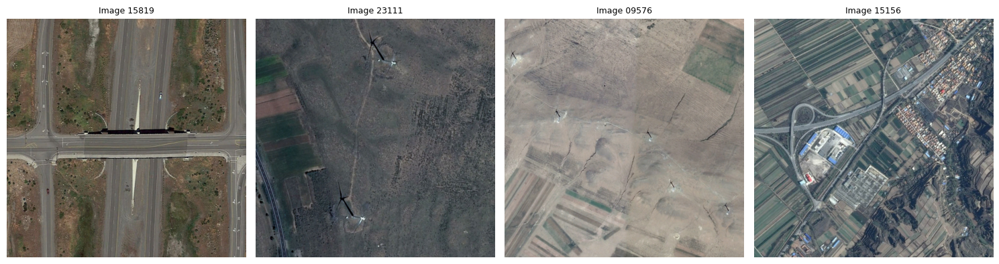

In [12]:
# import matplotlib.pyplot as plt
# from PIL import Image

# # List of specific image IDs you want to visualize
# image_ids = ['15819', '23111', '09576','15156']

# # Folder where original images are stored
# original_images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'

# # Plot
# plt.figure(figsize=(15, 5))
# for i, img_id in enumerate(image_ids):
#     img_path = os.path.join(original_images_dir, f"{img_id}.jpg")
#     if os.path.exists(img_path):
#         img = Image.open(img_path)
#         plt.subplot(1, len(image_ids), i + 1)
#         plt.imshow(img)
#         plt.title(f"Image {img_id}", fontsize=9)
#         plt.axis('off')
# plt.tight_layout()
# plt.show()


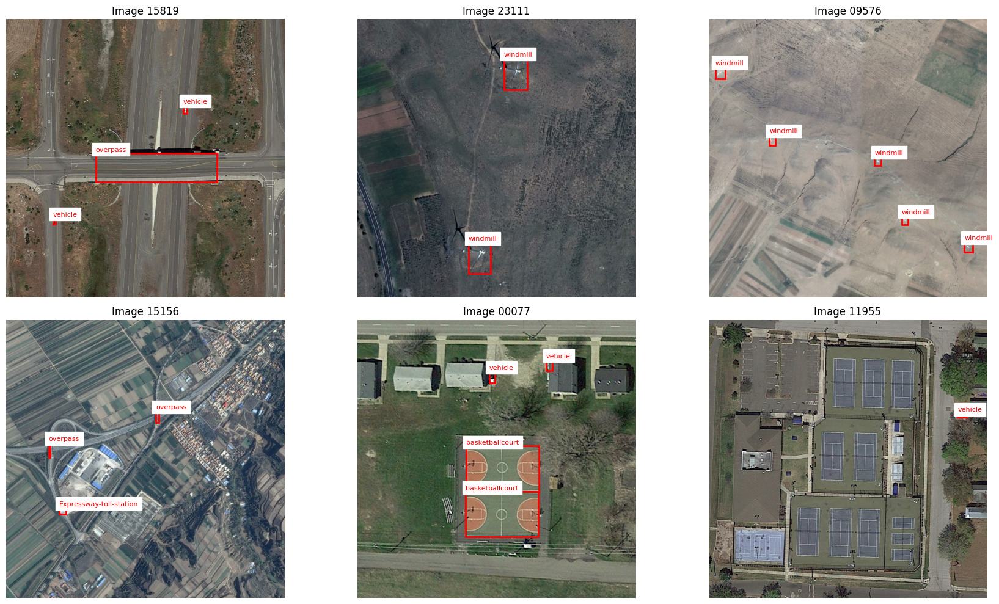

In [14]:
import os
import xml.etree.ElementTree as ET
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Updated IDs of images to visualize
image_ids = ['15819', '23111', '09576', '15156', '00077', '11955']

# Paths
images_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/JPEGImages'
annotations_dir = '/kaggle/input/rsvg-kaggle/RSVG_kaggle/Annotations'

# Plot setup
plt.figure(figsize=(18, 10))

for i, img_id in enumerate(image_ids):
    img_path = os.path.join(images_dir, f"{img_id}.jpg")
    xml_path = os.path.join(annotations_dir, f"{int(img_id):05d}.xml")

    # Load image
    img = Image.open(img_path)
    width, height = img.size

    # Create a plot
    ax = plt.subplot(2, 3, i + 1)  # 2 rows, 3 columns (6 images)
    ax.imshow(img)
    ax.set_title(f"Image {img_id}")
    ax.axis('off')

    # Load annotation
    if os.path.exists(xml_path):
        tree = ET.parse(xml_path)
        root = tree.getroot()

        for obj in root.findall('object'):
            label = obj.find('name').text
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Draw bounding box
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                     linewidth=2, edgecolor='red', facecolor='none')
            ax.add_patch(rect)
            ax.text(xmin, ymin - 5, label, color='red', fontsize=8, backgroundcolor='white')

plt.tight_layout()
plt.show()
